In [2]:
import pygsp as p
import numpy as np
import matplotlib.pyplot as plt

In [6]:
np.random.uniform(0, 2 * np.pi)

1.1535570339136823

In [7]:
ps = []
n = 100
for i in range(n):
    theta = np.random.uniform(0, 2 * np.pi)
    eps = np.random.uniform(-0.2, 0.2)
    x, y  = (1 + eps) * np.cos(theta), (1 + eps) * np.sin(theta)
    ps += [[x,y]]

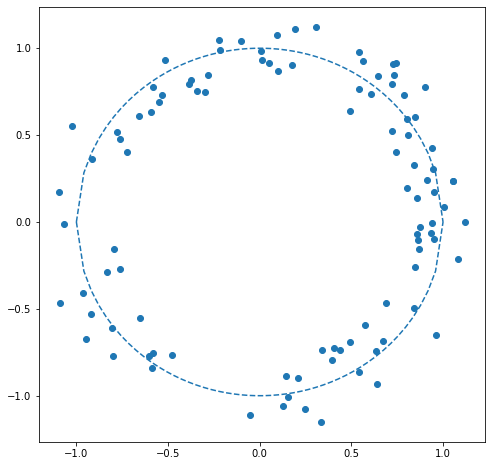

In [8]:
fig, ax = plt.subplots(figsize = (8,8))
ax.scatter([q[0] for q in ps], [q[1] for q in ps])
ax.plot(np.linspace(-1,1), np.sqrt(1 - np.linspace(-1, 1) ** 2), '--', color = 'tab:blue')
ax.plot(np.linspace(-1,1), -np.sqrt(1 - np.linspace(-1, 1) ** 2), '--', color = 'tab:blue')
plt.show()

In [10]:
ps = np.array([np.array(q) for q in ps])

In [11]:
np.shape(ps)

(100, 2)

In [13]:
# s = 10 * np.ones(len(ps)) + np.random.uniform(-5, 5, size = len(ps))

In [32]:
eps = 1
G = p.graphs.NNGraph(Xin = ps, NNtype = 'radius', epsilon = eps)

In [33]:
G.is_connected()

True

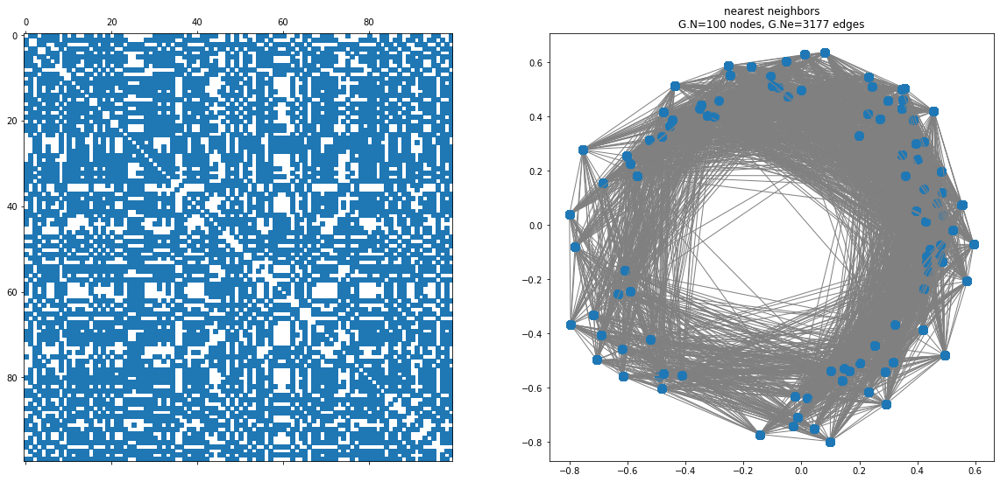

In [34]:
fig, axes = plt.subplots(1, 2, figsize = (20, 9))
_ = axes[0].spy(G.W, markersize=5)
G.plot(ax=axes[1])
# G.plot_signal(s, ax=axes[1])

In [18]:
G.compute_fourier_basis()

In [19]:
s_hat = G.gft(s)
s_star = G.igft(s_hat)

In [20]:
np.shape(s_hat)


(100,)

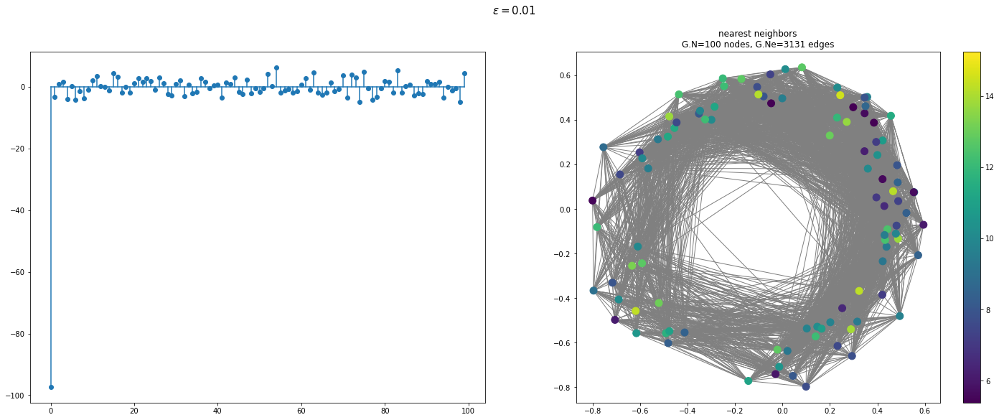

In [72]:
fig, ax = plt.subplots(1, 2, figsize = (25, 9))
for i,si in enumerate(s_hat):
    ax[0].plot([i, i],[0, si], color = 'tab:blue')
#     ax[0].scatter([i, i],[0, si], color = 'tab:blue')
# ax[0].scatter([[i, s[0]] for i, s in enumerate(s_hat)])
ax[0].scatter(np.arange(len(s_hat)), s_hat)
ax[0].plot([0, len(s_hat) - 1], [0, 0])
# ax[0].plot(np., s_hat, 'o')
# ax[0].plot(s_hat, 'o')
G.plot_signal(s, ax = ax[1])

fig.suptitle(r'$\varepsilon = 0.0$' + str(1), fontsize = 15)
plt.savefig('imgs/' + str(int(eps * 100)))

In [ ]:
eps = 1
G = p.graphs.NNGraph(Xin = ps, NNtype = 'radius', epsilon = eps)

Text(0.5, 1.0, '$\\hat s$: signal in the spectral domain')

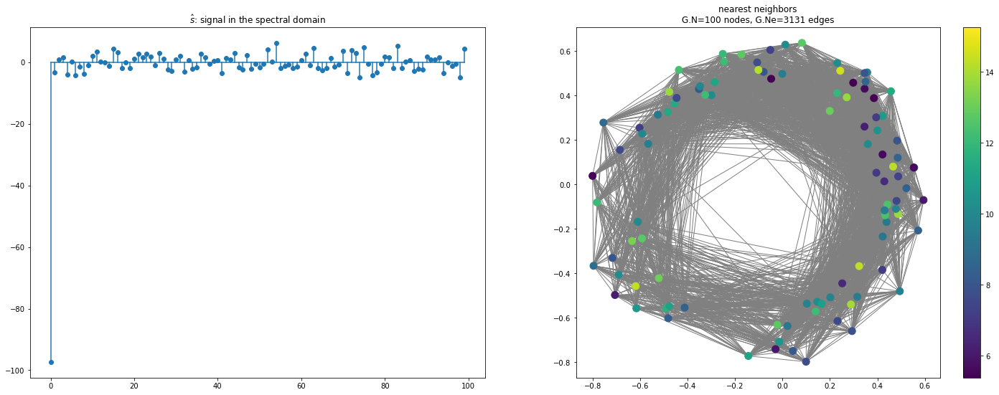

In [46]:
fig, ax = plt.subplots(1, 2, figsize = (25, 9))
for i,si in enumerate(s_hat):
    ax[0].plot([i, i],[0, si], color = 'tab:blue')
#     ax[0].scatter([i, i],[0, si], color = 'tab:blue')
# ax[0].scatter([[i, s[0]] for i, s in enumerate(s_hat)])
ax[0].scatter(np.arange(len(s_hat)), s_hat)
ax[0].plot([0, len(s_hat) - 1], [0, 0])
# ax[0].plot(np., s_hat, 'o')
# ax[0].plot(s_hat, 'o')
G.plot_signal(s, ax = ax[1])
ax[0].set_title(r'$\hat s$: signal in the spectral domain', )


In [70]:
np.round(np.arange(0.01, 1, 0.01)[6], 2)

0.07

<ipython-input-77-940c979c94c5>:6: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(1, 2, figsize = (25, 9))


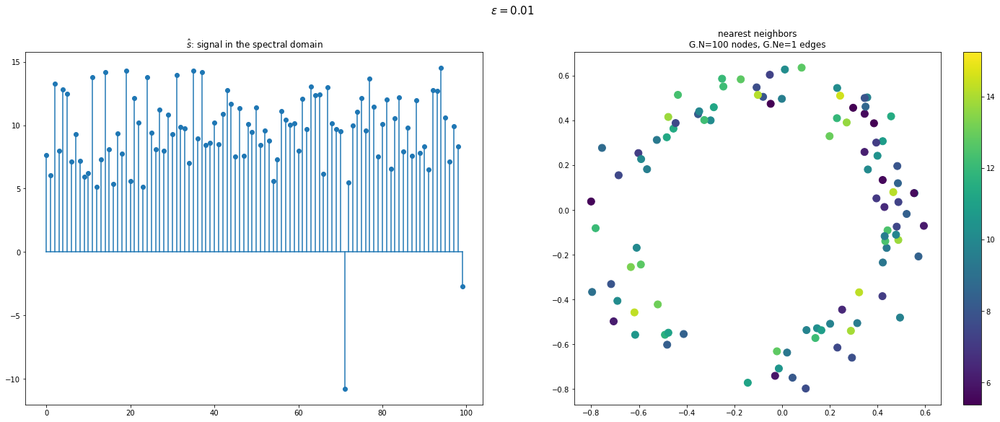

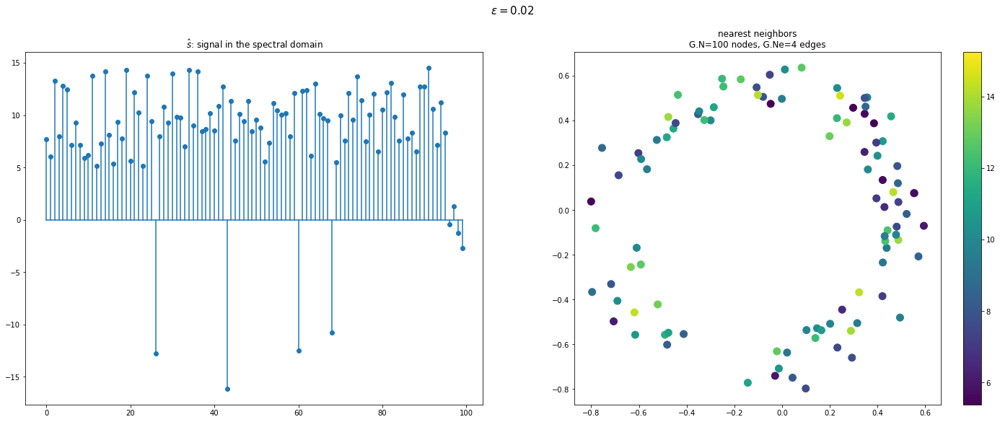

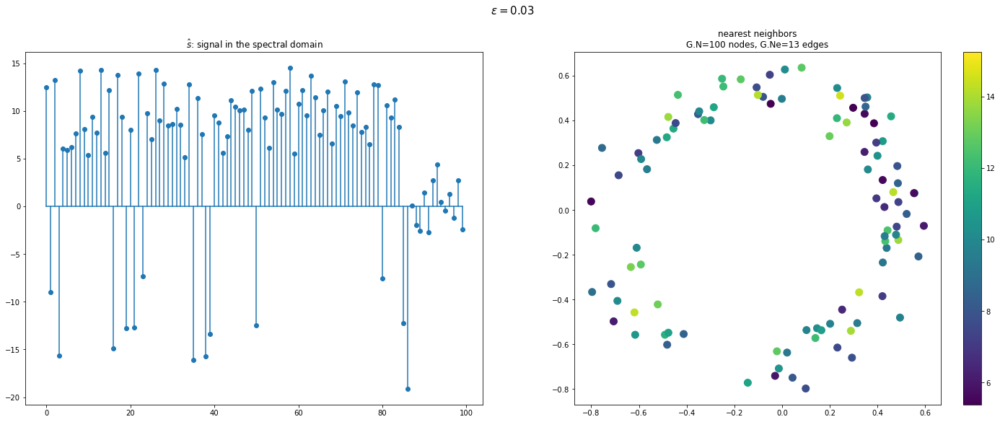

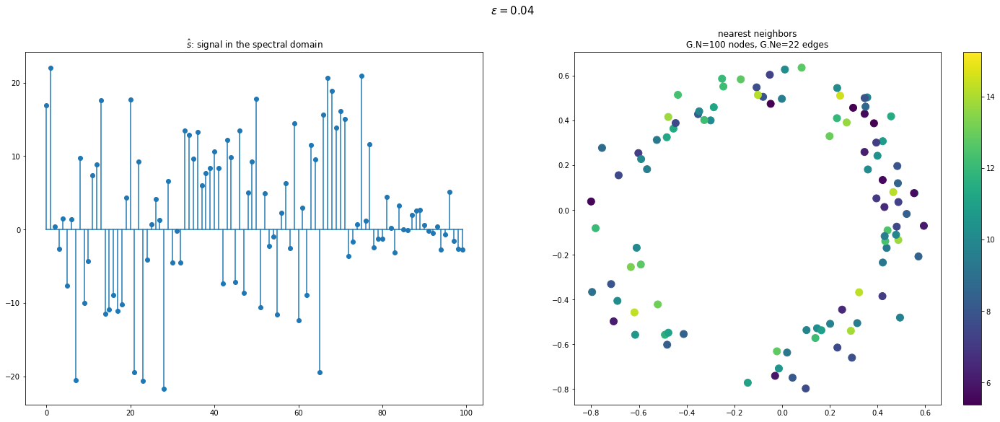

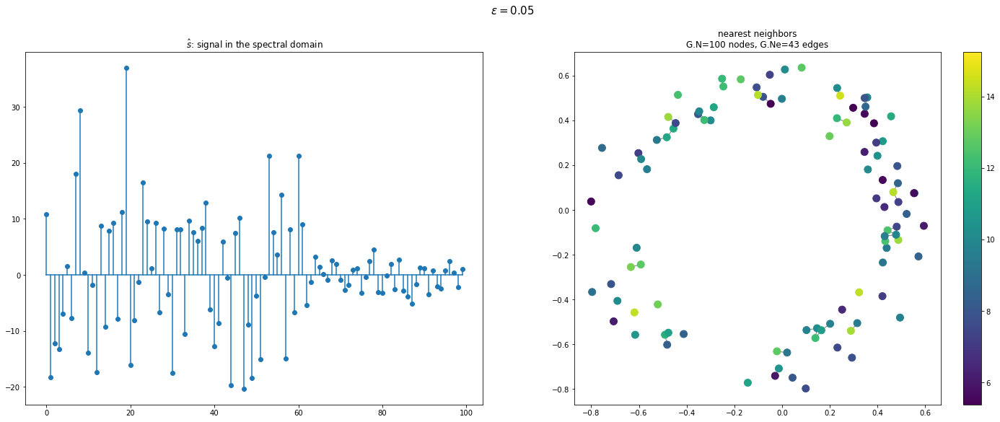

...

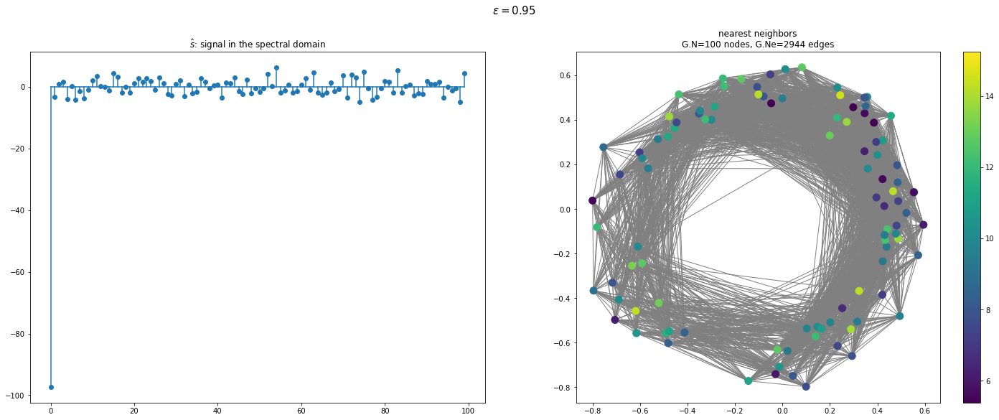

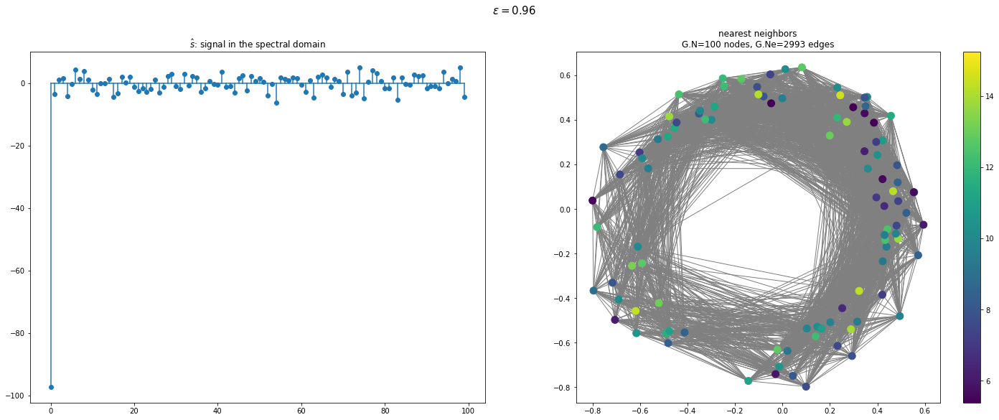

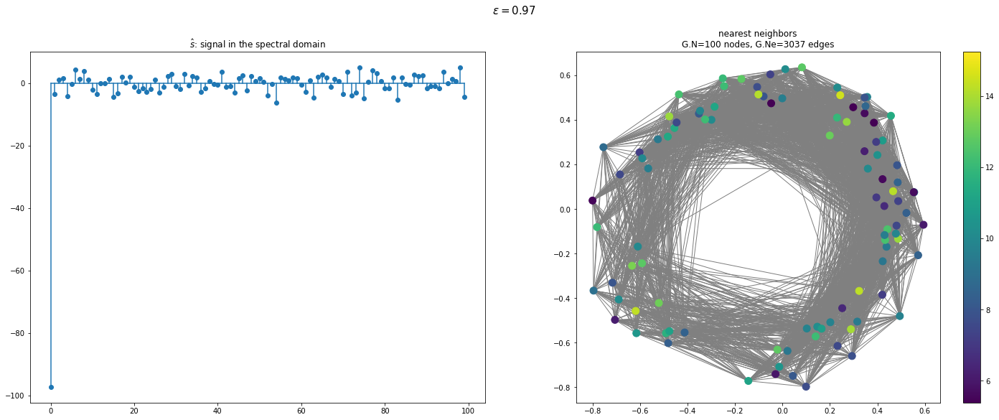

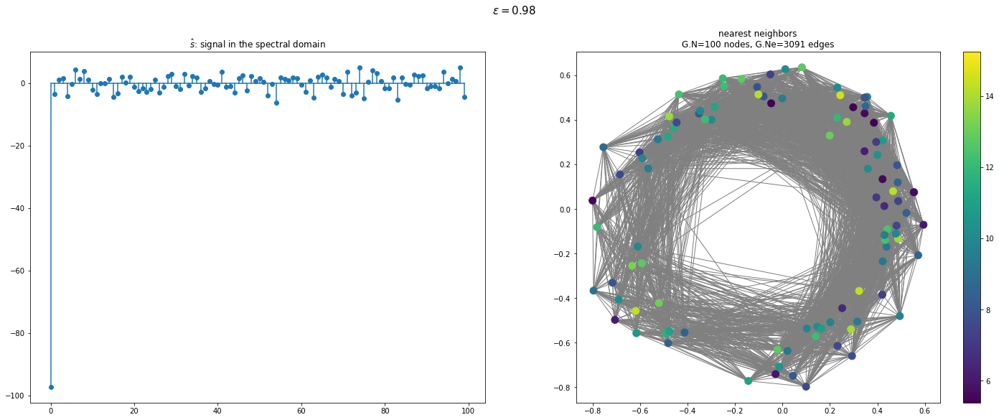

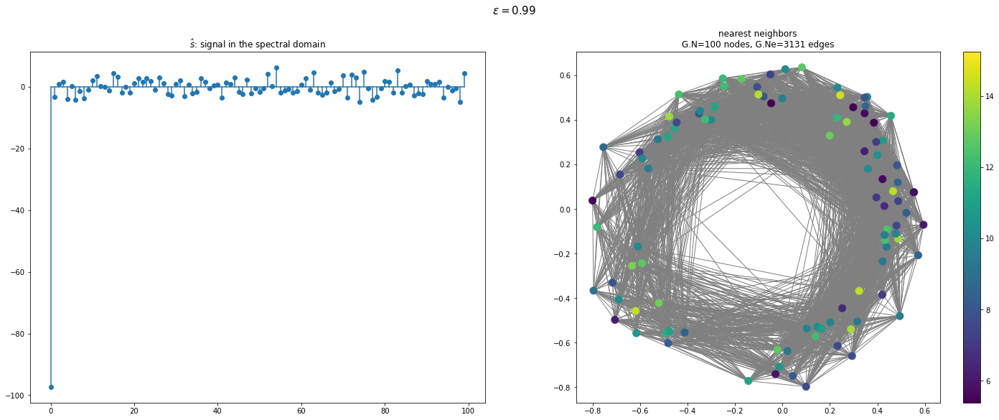

In [77]:
for j, eps in enumerate(np.arange(0.01, 1, 0.01)):
    G = p.graphs.NNGraph(Xin = ps, NNtype = 'radius', epsilon = eps)
    G.compute_fourier_basis()
    s_hat = G.gft(s)
#     s_star = G.igft(s_hat)
    fig, ax = plt.subplots(1, 2, figsize = (25, 9))
    for i,si in enumerate(s_hat):
        ax[0].plot([i, i],[0, si], color = 'tab:blue')
    #     ax[0].scatter([i, i],[0, si], color = 'tab:blue')
    # ax[0].scatter([[i, s[0]] for i, s in enumerate(s_hat)])
    ax[0].scatter(np.arange(len(s_hat)), s_hat)
    ax[0].plot([0, len(s_hat) - 1], [0, 0])
    # ax[0].plot(np., s_hat, 'o')
    # ax[0].plot(s_hat, 'o')
    G.plot_signal(s, ax = ax[1])

    fig.suptitle(r'$\varepsilon = $' + str(np.round(eps, 2)), fontsize = 15)
    
    ax[0].set_title(r'$\hat s$: signal in the spectral domain', )
    plt.savefig('imgs/' + str(j + 1))

In [78]:
import imageio

In [80]:
images = []
filenames = ['imgs/' + str(i) + '.png' for i in range(1, 100)]
for filename in filenames:
    images.append(imageio.imread(filename))
imageio.mimsave('gifs/tdagft.gif', images)